**Install All the Ultralytics Package**

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"


In [ ]:

import IPython
import sys

def clean_notebook():
    IPython.display.clear_output(wait=True)
    print("Notebook cleaned.")

# Run the installation commands
!pip install opendatasets
!pip install ultralytics
!pip install roboflow

# Clean up the notebook
clean_notebook()


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 871.0/871.0 kB 48.2 MB/s eta 0:00:00


**Import All the Required Libraries**

In [ ]:
from ultralytics import YOLO
from IPython.display import Image

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:

import ultralytics
ultralytics.checks()

**Download the Dataset from Roboflow**

In [ ]:


from roboflow import Roboflow
rf = Roboflow(api_key="OUx13M4wAVBt0qeZboyR")
project = rf.workspace("project-uyrxf").project("potholes-detection-segmentation")
version = project.version(1)
dataset = version.download("yolov11")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.4/80.4 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 5.2 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Potholes-Detection-Segmentation-1 in yolov11:: 100%|██████████| 1572/1572 [00:00<00:00, 5567.91it/s]


In [ ]:
dataset.location

'/content/Potholes-Detection-Segmentation-1'

**Train the YOLO11 Segmentation Model on a Custom Dataset**

In [ ]:
#Load the YOLO11-Seg Model
model = YOLO("yolo11s-seg.pt")

100%|██████████| 19.7M/19.7M [00:00<00:00, 240MB/s]


**Please make sure to update the train and validation dataset images path before starting training**

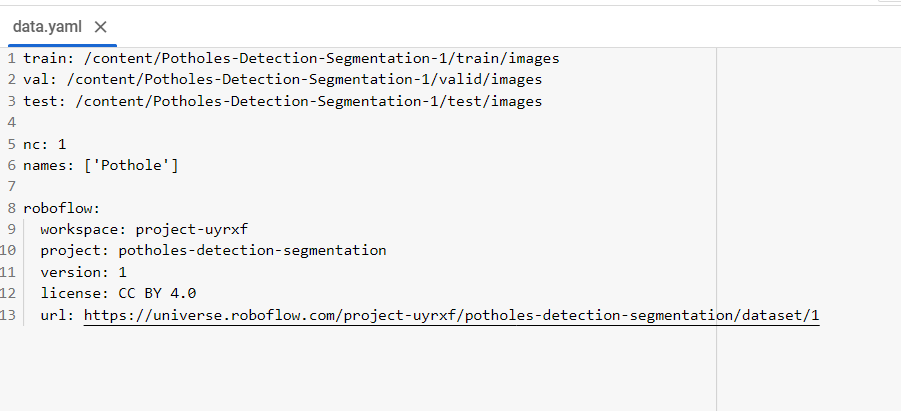

In [ ]:
#Train the Model on a Custom Dataset
results = model.train(task='segment', mode = 'train', data = "/content/Potholes-Detection-Segmentation-1/data.yaml", epochs = 50)

Ultralytics 8.3.12 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=segment, mode=train, model=yolo11s-seg.pt, data=/content/Pothole-Image-Segmentation-1/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, 

100%|██████████| 755k/755k [00:00<00:00, 24.0MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  6                  -1  1    346112  ultralytics.nn.modules.block.C3k2            [256, 256, 1, True]           
  7                  -1  1   1180672  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 95.9MB/s]


AMP: checks passed ✅


train: Scanning /content/Pothole-Image-Segmentation-1/train/labels... 543 images, 0 backgrounds, 0 corrupt: 100%|██████████| 543/543 [00:00<00:00, 1556.32it/s]

train: New cache created: /content/Pothole-Image-Segmentation-1/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 1.4.18 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
val: Scanning /content/Pothole-Image-Segmentation-1/valid/labels... 157 images, 0 backgrounds, 0 corrupt: 100%|██████████| 157/157 [00:00<00:00, 1023.09it/s]

val: New cache created: /content/Pothole-Image-Segmentation-1/valid/labels.cache


Plotting labels to runs/segment/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 90 weight(decay=0.0), 101 weight(decay=0.0005), 100 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/segment/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       1/50       5.3G      1.609      3.245      2.944      1.596         85        640: 100%|██████████| 34/34 [00:20<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.68it/s]

                   all        157        480   0.000403     0.0396    0.00021   5.55e-05   0.000119     0.0104    5.8e-05   2.02e-05



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       2/50      5.32G      1.627      2.808      1.844      1.554         50        640: 100%|██████████| 34/34 [00:16<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.45it/s]

                   all        157        480    0.00823      0.138    0.00325    0.00109    0.00701       0.11    0.00255   0.000834



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       3/50      5.22G      1.697       2.86      1.834       1.63         67        640: 100%|██████████| 34/34 [00:15<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.45it/s]

                   all        157        480     0.0574      0.135     0.0178    0.00536     0.0466        0.1     0.0111     0.0026



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       4/50      5.26G       1.72      2.833      1.836      1.653         63        640: 100%|██████████| 34/34 [00:15<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.34it/s]

                   all        157        480      0.232      0.221      0.106     0.0398      0.205      0.192     0.0723     0.0213



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       5/50      5.24G      1.678      2.793      1.727      1.593         93        640: 100%|██████████| 34/34 [00:16<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.11it/s]

                   all        157        480      0.336      0.427      0.295      0.128      0.322      0.446       0.28      0.121



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       6/50      5.24G      1.647      2.669      1.678       1.57         75        640: 100%|██████████| 34/34 [00:16<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.19it/s]

                   all        157        480      0.594      0.429      0.445      0.219      0.597      0.431       0.44      0.203



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       7/50      5.19G      1.602      2.683      1.606      1.527         88        640: 100%|██████████| 34/34 [00:15<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.16it/s]

                   all        157        480      0.447      0.381      0.396      0.204      0.416      0.385      0.381       0.19



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       8/50      5.31G      1.547      2.636      1.572      1.507         43        640: 100%|██████████| 34/34 [00:15<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.14it/s]

                   all        157        480       0.56      0.622      0.545      0.268       0.56        0.6      0.518      0.258



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


       9/50      5.22G      1.537      2.568      1.555      1.509         71        640: 100%|██████████| 34/34 [00:15<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.49it/s]

                   all        157        480      0.681      0.519      0.584      0.307      0.687      0.531      0.585      0.295



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      10/50      5.24G      1.492      2.438      1.436      1.453         61        640: 100%|██████████| 34/34 [00:15<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.87it/s]

                   all        157        480      0.606      0.579      0.599      0.316       0.61      0.566      0.591      0.302



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      11/50      5.24G      1.519      2.503      1.471      1.483         82        640: 100%|██████████| 34/34 [00:16<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.22it/s]

                   all        157        480      0.631      0.645      0.671      0.367      0.639      0.645      0.664      0.338



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      12/50      5.27G      1.436      2.345      1.368      1.425         59        640: 100%|██████████| 34/34 [00:18<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.87it/s]

                   all        157        480      0.681      0.631      0.685      0.374      0.682      0.638      0.685      0.366



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      13/50      5.32G      1.413      2.317      1.338      1.416         53        640: 100%|██████████| 34/34 [00:15<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.78it/s]

                   all        157        480      0.639        0.6      0.651      0.357      0.644      0.629       0.66      0.342



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      14/50      5.24G      1.405      2.362      1.346      1.404         57        640: 100%|██████████| 34/34 [00:15<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.44it/s]

                   all        157        480      0.668      0.706      0.729      0.409      0.684      0.708      0.725      0.385



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      15/50      5.18G      1.403      2.331      1.305      1.403         78        640: 100%|██████████| 34/34 [00:15<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.79it/s]

                   all        157        480      0.692      0.694      0.727      0.412      0.698      0.713      0.732      0.391



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      16/50      5.23G      1.351      2.238      1.284      1.382         50        640: 100%|██████████| 34/34 [00:15<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.22it/s]

                   all        157        480      0.765      0.715      0.771      0.435      0.766      0.715      0.766      0.407



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      17/50       5.2G      1.338      2.251       1.27       1.38         78        640: 100%|██████████| 34/34 [00:16<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.28it/s]

                   all        157        480      0.702      0.698      0.743      0.423      0.714      0.708      0.745      0.406



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      18/50      5.27G      1.315      2.154       1.18      1.345         59        640: 100%|██████████| 34/34 [00:16<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.25it/s]

                   all        157        480      0.757      0.656      0.748      0.443      0.769      0.665       0.76       0.41



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      19/50       5.3G      1.307       2.14       1.19      1.349         64        640: 100%|██████████| 34/34 [00:15<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.82it/s]

                   all        157        480      0.671       0.71      0.742      0.425      0.671       0.71      0.734      0.396



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      20/50      5.31G      1.352      2.218      1.222      1.375         67        640: 100%|██████████| 34/34 [00:15<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.43it/s]

                   all        157        480      0.723      0.698      0.739      0.423      0.719      0.694      0.734      0.398



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      21/50      5.32G      1.259      2.072      1.146      1.304         76        640: 100%|██████████| 34/34 [00:15<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.20it/s]

                   all        157        480      0.712      0.738      0.777      0.456      0.701      0.725      0.758      0.426



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      22/50      5.25G      1.267      2.058      1.126      1.314         69        640: 100%|██████████| 34/34 [00:17<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.16it/s]

                   all        157        480       0.73      0.734       0.77      0.461      0.733      0.735       0.77      0.429



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      23/50      5.22G      1.278      2.085      1.129      1.316         49        640: 100%|██████████| 34/34 [00:15<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.25it/s]

                   all        157        480      0.714      0.748      0.793       0.48      0.725      0.753      0.796      0.454



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      24/50      5.26G      1.238      2.095      1.092      1.287         60        640: 100%|██████████| 34/34 [00:15<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.10it/s]

                   all        157        480      0.758      0.731      0.804      0.492      0.764       0.74      0.805      0.466



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      25/50      5.28G      1.256      2.138      1.123      1.317         66        640: 100%|██████████| 34/34 [00:15<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.43it/s]

                   all        157        480      0.714      0.767      0.808      0.488      0.713      0.762      0.804      0.458



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      26/50      5.23G      1.199      2.022      1.028      1.282         64        640: 100%|██████████| 34/34 [00:15<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.70it/s]

                   all        157        480      0.775      0.779      0.842      0.517      0.776      0.779      0.838      0.481



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      27/50      5.19G      1.204          2      1.004      1.266         63        640: 100%|██████████| 34/34 [00:15<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.25it/s]

                   all        157        480      0.763      0.758      0.815      0.504      0.765       0.76      0.808      0.472



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      28/50      5.22G      1.191      2.008       1.02      1.264         61        640: 100%|██████████| 34/34 [00:15<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.28it/s]

                   all        157        480        0.7      0.652      0.704      0.428      0.701      0.656      0.694      0.403



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      29/50      5.24G      1.254      2.062      1.058      1.304         89        640: 100%|██████████| 34/34 [00:16<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.27it/s]

                   all        157        480      0.785       0.75      0.826      0.515      0.789      0.754      0.828      0.483



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      30/50       5.3G      1.168       1.92     0.9818      1.252         74        640: 100%|██████████| 34/34 [00:16<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.30it/s]

                   all        157        480      0.793      0.767      0.827      0.512      0.796      0.756      0.823      0.483



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      31/50      5.21G      1.187      1.928     0.9745      1.246         70        640: 100%|██████████| 34/34 [00:15<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.58it/s]

                   all        157        480      0.813      0.748      0.833      0.525      0.813      0.752      0.824       0.49



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      32/50      5.26G      1.159       1.89     0.9545      1.231        106        640: 100%|██████████| 34/34 [00:17<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.40it/s]

                   all        157        480        0.8      0.752      0.844      0.519      0.799       0.75      0.841       0.49



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      33/50      5.23G      1.128      1.874     0.9506      1.223         64        640: 100%|██████████| 34/34 [00:15<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.20it/s]

                   all        157        480      0.835      0.731      0.833      0.526       0.83      0.717      0.827      0.494



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      34/50      5.21G      1.127      1.821     0.9265       1.22         42        640: 100%|██████████| 34/34 [00:16<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.29it/s]

                   all        157        480      0.807      0.749      0.842      0.512      0.828      0.733      0.844      0.483



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      35/50      5.23G       1.12      1.882     0.8998      1.201         69        640: 100%|██████████| 34/34 [00:16<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.25it/s]

                   all        157        480      0.822      0.762      0.848      0.526       0.82      0.783       0.85      0.494



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      36/50      5.23G       1.09      1.837     0.8896      1.193         66        640: 100%|██████████| 34/34 [00:16<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.28it/s]

                   all        157        480       0.78        0.8      0.847      0.556      0.782      0.802      0.852      0.521



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      37/50      5.29G       1.06      1.813      0.846      1.183         55        640: 100%|██████████| 34/34 [00:16<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.99it/s]

                   all        157        480      0.887      0.767      0.875      0.562      0.882      0.762      0.873      0.537



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      38/50      5.31G      1.069       1.78      0.855      1.177         80        640: 100%|██████████| 34/34 [00:15<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.41it/s]

                   all        157        480      0.805      0.792      0.852      0.539        0.8      0.787      0.852      0.515



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      39/50      5.27G      1.108      1.786     0.8443      1.189         58        640: 100%|██████████| 34/34 [00:15<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.08it/s]

                   all        157        480      0.808      0.812      0.872       0.57      0.812      0.812      0.874      0.541



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      40/50      5.27G      1.053       1.78     0.8362      1.172         56        640: 100%|██████████| 34/34 [00:16<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.26it/s]

                   all        157        480      0.792      0.852      0.881      0.565      0.797      0.854      0.883      0.536


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      41/50      5.14G      1.029       1.73     0.7678       1.18         32        640: 100%|██████████| 34/34 [00:17<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.30it/s]

                   all        157        480      0.799       0.81      0.858      0.561      0.812      0.811      0.858      0.533



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      42/50      5.24G      1.018      1.656     0.7264      1.161         24        640: 100%|██████████| 34/34 [00:17<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.53it/s]

                   all        157        480      0.882      0.769      0.875      0.582      0.874      0.766       0.87      0.555



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      43/50      5.22G     0.9961      1.633     0.7094      1.142         32        640: 100%|██████████| 34/34 [00:14<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:03<00:00,  1.53it/s]

                   all        157        480      0.849       0.83      0.887      0.587      0.851      0.832      0.889      0.561



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      44/50      5.23G     0.9536       1.61     0.6586      1.118         25        640: 100%|██████████| 34/34 [00:15<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.03it/s]

                   all        157        480      0.828      0.845      0.883      0.604      0.831       0.84      0.884      0.569



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      45/50      5.12G     0.9795      1.588     0.6664      1.141         30        640: 100%|██████████| 34/34 [00:15<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.31it/s]

                   all        157        480      0.866      0.817      0.885      0.606      0.866      0.817      0.889      0.565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      46/50      5.22G     0.9341      1.548      0.638      1.111         30        640: 100%|██████████| 34/34 [00:15<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.29it/s]

                   all        157        480      0.878      0.819      0.895      0.605      0.881      0.819       0.89      0.568



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      47/50      5.15G     0.9352       1.55     0.6243      1.102         39        640: 100%|██████████| 34/34 [00:15<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.28it/s]

                   all        157        480      0.889      0.835      0.902       0.61      0.887      0.833      0.898      0.576



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      48/50      5.16G     0.9028      1.521     0.5985      1.088         30        640: 100%|██████████| 34/34 [00:15<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.29it/s]

                   all        157        480      0.894      0.825      0.902      0.614      0.896      0.827      0.902      0.583



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      49/50       5.2G     0.9003      1.495     0.6003      1.082         31        640: 100%|██████████| 34/34 [00:15<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.30it/s]

                   all        157        480      0.879      0.859      0.907      0.621      0.883      0.848      0.905      0.586



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      50/50      5.18G     0.8842       1.49     0.5872      1.089         36        640: 100%|██████████| 34/34 [00:15<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.77it/s]

                   all        157        480      0.899      0.831      0.908      0.623      0.901      0.833       0.91      0.584



50 epochs completed in 0.277 hours.
Optimizer stripped from runs/segment/train/weights/last.pt, 20.5MB
Optimizer stripped from runs/segment/train/weights/best.pt, 20.5MB

Validating runs/segment/train/weights/best.pt...
Ultralytics 8.3.12 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,203 parameters, 0 gradients, 35.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:06<00:00,  1.37s/it]


                   all        157        480      0.899      0.835      0.908      0.623      0.901      0.837       0.91      0.585
Speed: 0.4ms preprocess, 7.1ms inference, 0.0ms loss, 6.9ms postprocess per image
Results saved to runs/segment/train


**Download the Best Model Weights**

In [ ]:
!gdown "https://drive.google.com/uc?id=1DnQ3jNXUn4SxMjW5KtHGfzjNHY79VjR3&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1DnQ3jNXUn4SxMjW5KtHGfzjNHY79VjR3&confirm=t
To: /content/best.pt
100% 20.5M/20.5M [00:00<00:00, 48.7MB/s]


**Examining Results**

**Box and Mask Curves of Precision-Confidence and Recall - Confidence**

In [ ]:
train_path = "/content/runs/segment/train"

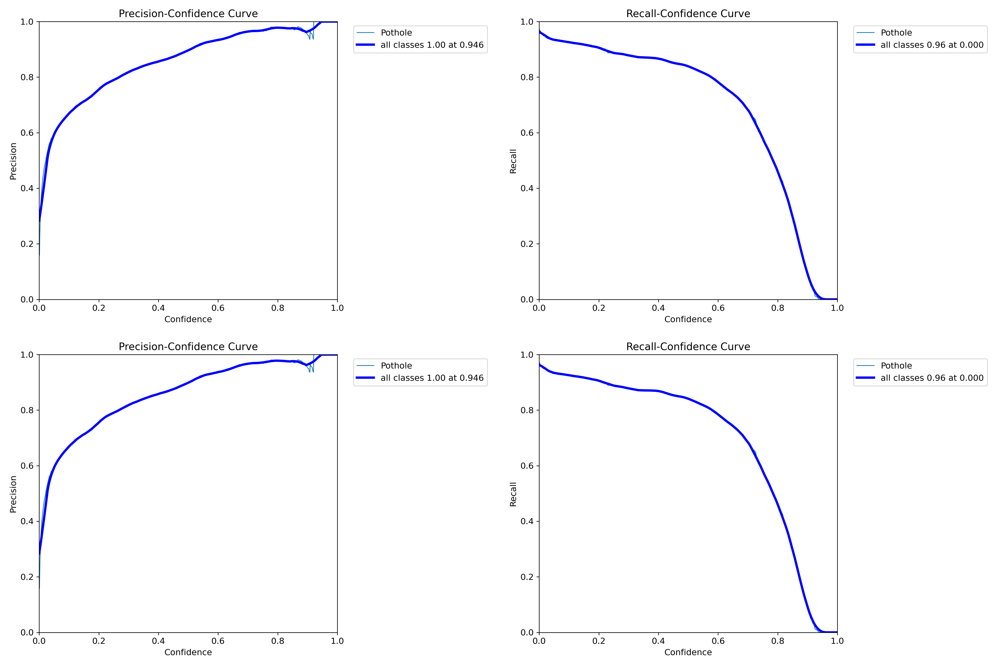

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
#Load your images using OpenCV
img1 = cv2.imread(f"{train_path}/BoxP_curve.png")
img2 = cv2.imread(f"{train_path}/BoxR_curve.png")
img3 = cv2.imread(f"{train_path}/MaskP_curve.png")
img4 = cv2.imread(f"{train_path}/MaskR_curve.png")

#Concatenate the images horizontally
top_row = cv2.hconcat([img1, img2])
botton_row = cv2.hconcat([img3, img4])

#Concatenate the two rows vertically
grid = cv2.vconcat([top_row, botton_row])
#Display the concatenated images
cv2_imshow(grid)


**Confusion Matrix**

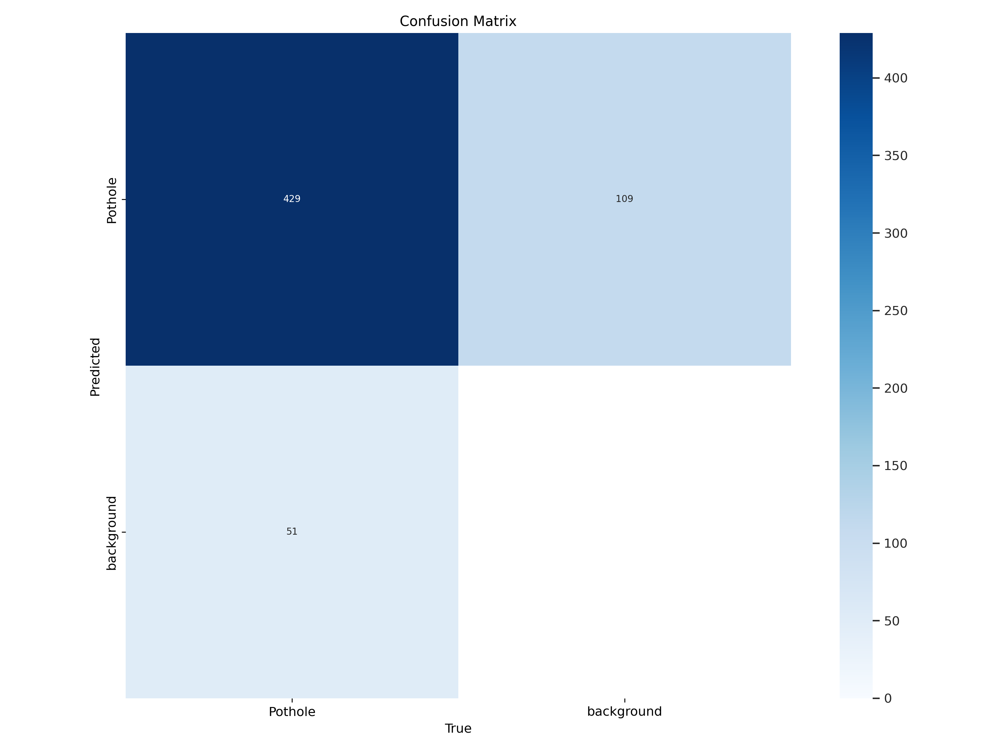

In [ ]:
Image("/content/runs/segment/train/confusion_matrix.png", width = 800)

**Normalized Confusion Matrix**

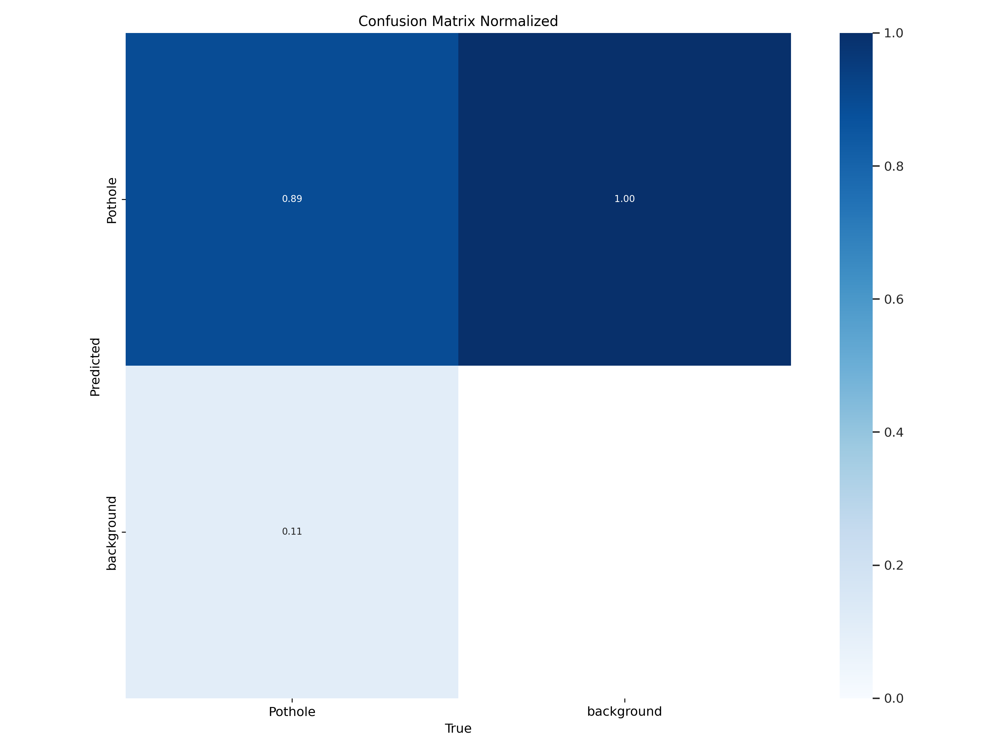

In [ ]:
Image("/content/runs/segment/train/confusion_matrix_normalized.png", width = 800)

**Model Prediction on Validation Batch**

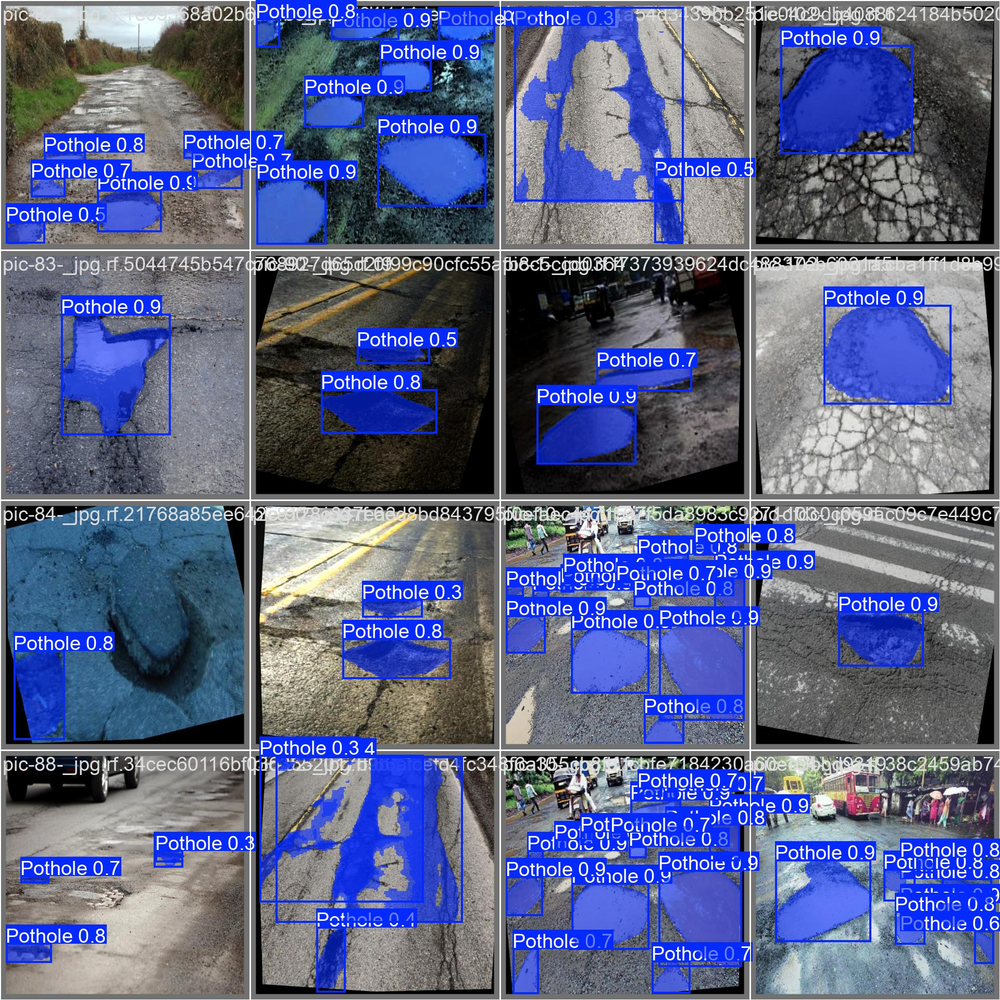

In [ ]:
Image("/content/runs/segment/train/val_batch0_pred.jpg", width = 800)

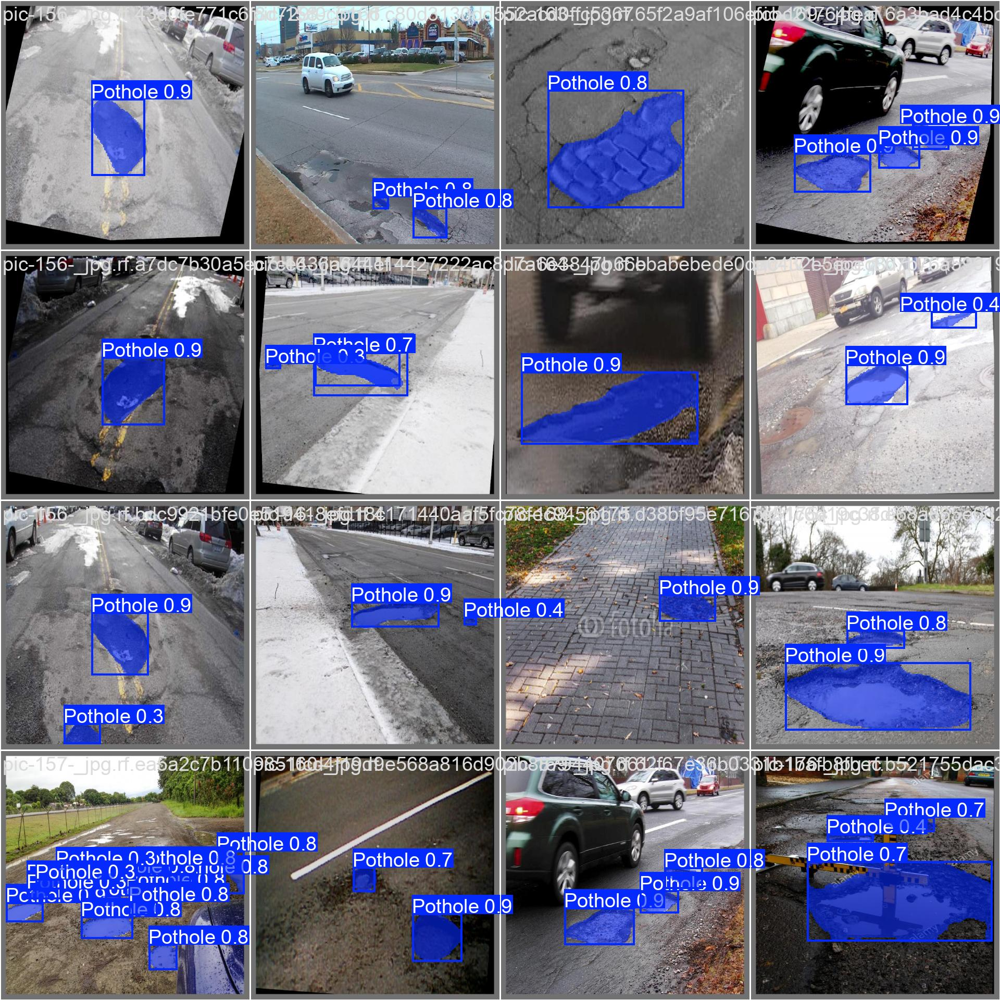

In [ ]:
Image("/content/runs/segment/train/val_batch1_pred.jpg", width = 800)

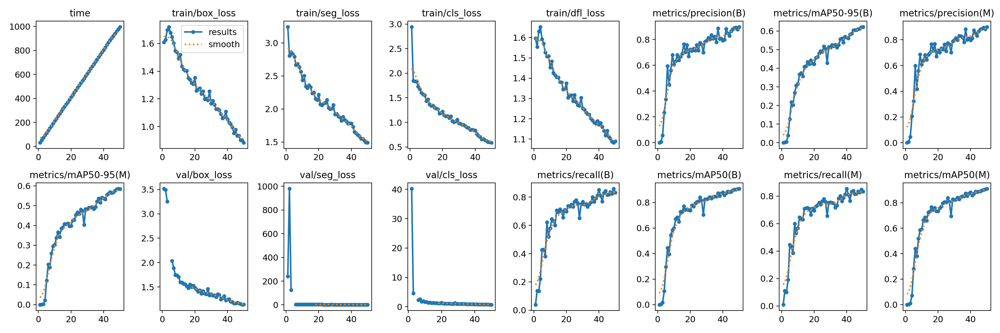

In [ ]:
Image("/content/runs/segment/train/results.png", width = 800)

**Validate Fine-Tuned Model**

In [ ]:
metrics = model.val()
# Print the evaluation metrics
print("Model Evaluation Metrics:", metrics)


Ultralytics 8.3.12 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11s-seg summary (fused): 265 layers, 10,067,203 parameters, 0 gradients, 35.3 GFLOPs


val: Scanning /content/Pothole-Image-Segmentation-1/valid/labels.cache... 157 images, 0 backgrounds, 0 corrupt: 100%|██████████| 157/157 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:09<00:00,  1.06it/s]


                   all        157        480      0.901      0.831      0.909      0.622      0.903      0.833       0.91      0.581
Speed: 0.6ms preprocess, 14.6ms inference, 0.0ms loss, 7.8ms postprocess per image
Results saved to runs/segment/train2
Model Evaluation Metrics: ultralytics.utils.metrics.SegmentMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7fe3d404b670>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(M)', 'F1-Confidence(M)', 'Precision-Confidence(M)', 'Recall-Confidence(M)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,  

**Inference on Test Dataset Images**

In [ ]:
#Predict on Test Images using Trained Model
import os

#Load Trained Model
model = YOLO("/content/best.pt")

#Specify the test folder path
test_path = "/content/Potholes-Detection-Segmentation-1/test/images"

#List all images in the test folder
image_files = [os.path.join(test_path, f) for f in os.listdir(test_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

#Predict each images
for img_path in image_files:
  results = model.predict(source = img_path, save = True, conf = 0.20)


image 1/1 /content/Potholes-Detection-Segmentation-1/test/images/pic-128-_jpg.rf.e698fb9ae6119683d121c364620f0e5f.jpg: 640x640 1 Pothole, 20.2ms
Speed: 7.9ms preprocess, 20.2ms inference, 816.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/segment/predict

image 1/1 /content/Potholes-Detection-Segmentation-1/test/images/pic-81-_jpg.rf.ec69e8068cc3886ff95e297183e8298e.jpg: 640x640 1 Pothole, 20.2ms
Speed: 2.2ms preprocess, 20.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/segment/predict

image 1/1 /content/Potholes-Detection-Segmentation-1/test/images/pic-240-_jpg.rf.556bec537d06be4a2b55a528b35305bb.jpg: 640x640 2 Potholes, 20.1ms
Speed: 1.4ms preprocess, 20.1ms inference, 25.1ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/segment/predict

image 1/1 /content/Potholes-Detection-Segmentation-1/test/images/pic-55-_jpg.rf.08a61f4a99918ccc2c5f21cb1fad14bb.jpg: 640x640 3 Potholes, 20.1ms
Speed: 1

**Plot Prediction on Test Images**

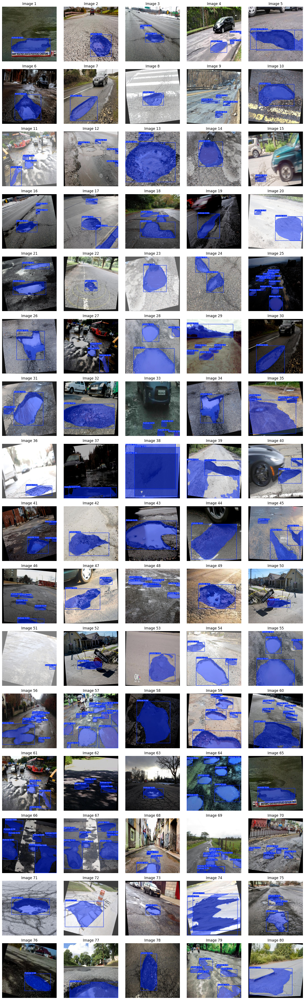

In [ ]:
# Plot prediction on test images
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
# Specify the predict folder path
pred_path = '/content/runs/segment/predict'

# List all images in the predict folder
pred_image_files = [os.path.join(pred_path, img) for img in os.listdir(pred_path) if img.endswith(('.jpg', '.jpeg', '.png'))]

# Number of images per row
images_per_row = 5

# Calculate the number of rows needed
n_rows = len(pred_image_files) // images_per_row + int(len(pred_image_files) % images_per_row != 0)

# Set figure size
fig, axs = plt.subplots(n_rows, images_per_row, figsize=(15, 3 * n_rows))

# Flatten axes if necessary (for easier iteration)
axs = axs.flatten()

# Loop through each image and display it
for i, img_path in enumerate(pred_image_files):
    img = mpimg.imread(img_path)      # Read the image
    axs[i].imshow(img)                # Show the image
    axs[i].axis('off')                # Turn off axis
    axs[i].set_title(f"Image {i+1}")  # Add title

# Hide any extra empty subplots (if the number of images is not a perfect multiple of images_per_row)
for j in range(i+1, len(axs)):
    axs[j].axis('off')  # Hide unused axes

# Display all images
plt.tight_layout()
plt.show()

**Inference on a Sample Video**

In [ ]:
!gdown "https://drive.google.com/uc?id=1iMitK9VCUWmBcZiiEPHK1d2pydALof6s&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1iMitK9VCUWmBcZiiEPHK1d2pydALof6s&confirm=t
To: /content/demo.mp4
100% 4.39M/4.39M [00:00<00:00, 17.8MB/s]


In [ ]:
results = model.predict(source = "/content/demo.mp4", save = True, conf = 0.25, iou = 0.3)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/324) /content/demo.mp4: 384x640 3 Potholes, 57.3ms
video 1/1 (frame 2/324) /content/demo.mp4: 384x640 3 Potholes, 13.9ms
video 1/1 (frame 3/324) /content/demo.mp4: 384x640 4 Potholes, 14.0ms
video 1/1 (frame 4/324) /content/demo.mp4: 384x640 4 Potholes, 14.4ms
video 1/1 (frame 5/324) /content/demo.mp4: 384x640 4 Potholes, 16.8ms
video 1/1 (frame 6/324) /content/demo.mp4: 384x640 4 Potholes, 13.9ms
video 1/1 (frame 7/324) /content/dem

In [ ]:
!rm "/content/result_compressed.mp4"

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/segment/predict/demo.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
!gdown "https://drive.google.com/uc?id=1_-JPW9TEWG_eyzWmT-jlfB2O5tzEiauW&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1_-JPW9TEWG_eyzWmT-jlfB2O5tzEiauW&confirm=t
To: /content/video2.mp4
100% 6.01M/6.01M [00:00<00:00, 17.4MB/s]


In [ ]:
results = model.predict(source = "/content/video2.mp4", save = True, conf = 0.25, iou = 0.3)



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/375) /content/video2.mp4: 384x640 4 Potholes, 27.6ms
video 1/1 (frame 2/375) /content/video2.mp4: 384x640 3 Potholes, 24.6ms
video 1/1 (frame 3/375) /content/video2.mp4: 384x640 4 Potholes, 27.7ms
video 1/1 (frame 4/375) /content/video2.mp4: 384x640 4 Potholes, 27.8ms
video 1/1 (frame 5/375) /content/video2.mp4: 384x640 4 Potholes, 30.0ms
video 1/1 (frame 6/375) /content/video2.mp4: 384x640 4 Potholes, 28.6ms
video 1/1 (frame 7/375) 

In [ ]:
!rm "/content/result_compressed.mp4"

In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/segment/predict/video2.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)